In [1]:
path = 'C:\\Github\\python_study\\Pandas\\pandas-data-analysis-main\\part4\\data'
# ex 시간대별 지하철 이용 현황

In [2]:
import pandas as pd
import matplotlib.pyplot as plt

In [109]:
from matplotlib import font_manager, rc
font_path = 'C:\\Windows\\Fonts\\batang.ttc'
font_name = font_manager.FontProperties(fname=font_path).get_name()
rc('font', family = font_name)

In [22]:
df = pd.read_excel(path+'/시도별_전출입_인구수.xlsx')
df.head()

,전출지별,전입지별,1970,1971,1972,1973,1974,1975,1976,1977,...,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
0,전출지별,전입지별,이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),...,이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명)
1,전국,전국,4046536,4210164,3687938,4860418,5297969,9011440,6773250,7397623,...,8808256,8487275,8226594,8127195,7506691,7411784,7629098,7755286,7378430,7154226
2,NaN,서울특별시,1742813,1671705,1349333,1831858,2050392,3396662,2756510,2893403,...,2025358,1873188,1733015,1721748,1555281,1520090,1573594,1589431,1515602,1472937
3,NaN,부산광역시,448577,389797,362202,482061,680984,805979,724664,785117,...,514502,519310,519334,508043,461042,478451,485710,507031,459015,439073
4,NaN,대구광역시,-,-,-,-,-,-,-,-,...,409938,398626,370817,370563,348642,351873,350213,351424,328228,321182


In [23]:
df.ffill(inplace=True)

In [24]:
df['전출지별'].unique()

array(['전출지별', '전국', '서울특별시', '부산광역시', '대구광역시', '인천광역시', '광주광역시', '대전광역시',
       '울산광역시', '세종특별자치시', '경기도', '강원도', '충청북도', '충청남도', '전라북도', '전라남도',
       '경상북도', '경상남도', '제주특별자치도'], dtype=object)

In [25]:
df['전출지별'].value_counts()

전출지별
전국         18
서울특별시      18
부산광역시      18
강원도        18
대구광역시      18
인천광역시      18
광주광역시      18
대전광역시      18
울산광역시      18
세종특별자치시    18
경기도        18
전라남도       18
충청북도       18
충청남도       18
전라북도       18
경상남도       18
경상북도       18
제주특별자치도    18
전출지별        1
Name: count, dtype: int64

In [26]:
df.info()
df.isna().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 325 entries, 0 to 324
Data columns (total 50 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   전출지별    325 non-null    object
 1   전입지별    325 non-null    object
 2   1970    325 non-null    object
 3   1971    325 non-null    object
 4   1972    325 non-null    object
 5   1973    325 non-null    object
 6   1974    325 non-null    object
 7   1975    325 non-null    object
 8   1976    325 non-null    object
 9   1977    325 non-null    object
 10  1978    325 non-null    object
 11  1979    325 non-null    object
 12  1980    325 non-null    object
 13  1981    325 non-null    object
 14  1982    325 non-null    object
 15  1983    325 non-null    object
 16  1984    325 non-null    object
 17  1985    325 non-null    object
 18  1986    325 non-null    object
 19  1987    325 non-null    object
 20  1988    325 non-null    object
 21  1989    325 non-null    object
 22  1990    325 non-null    ob

전출지별    0
전입지별    0
1970    0
1971    0
1972    0
1973    0
1974    0
1975    0
1976    0
1977    0
1978    0
1979    0
1980    0
1981    0
1982    0
1983    0
1984    0
1985    0
1986    0
1987    0
1988    0
1989    0
1990    0
1991    0
1992    0
1993    0
1994    0
1995    0
1996    0
1997    0
1998    0
1999    0
2000    0
2001    0
2002    0
2003    0
2004    0
2005    0
2006    0
2007    0
2008    0
2009    0
2010    0
2011    0
2012    0
2013    0
2014    0
2015    0
2016    0
2017    0
dtype: int64

In [82]:
df_data = df.loc[1:,'1970':]
df_data.head()
df_data.replace('-',0)

,1970,1971,1972,1973,1974,1975,1976,1977,1978,1979,...,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
1,4046536,4210164,3687938,4860418,5297969,9011440,6773250,7397623,8410276,7324380,...,8808256,8487275,8226594,8127195,7506691,7411784,7629098,7755286,7378430,7154226
2,1742813,1671705,1349333,1831858,2050392,3396662,2756510,2893403,3307439,2589667,...,2025358,1873188,1733015,1721748,1555281,1520090,1573594,1589431,1515602,1472937
3,448577,389797,362202,482061,680984,805979,724664,785117,895337,809483,...,514502,519310,519334,508043,461042,478451,485710,507031,459015,439073
4,0,0,0,0,0,0,0,0,0,0,...,409938,398626,370817,370563,348642,351873,350213,351424,328228,321182
5,0,0,0,0,0,0,0,0,0,0,...,565585,478169,462051,499567,468666,461613,452297,473223,441646,409465
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320,139,202,141,210,219,415,392,408,363,354,...,668,579,672,561,551,516,609,683,733,768
321,631,965,857,952,1133,2808,2608,2652,2722,2178,...,1143,1123,1002,1026,966,1001,928,1062,1127,1102
322,374,619,468,576,625,1123,1141,1004,1009,818,...,761,704,738,756,699,781,728,903,931,994
323,474,479,440,571,1208,1517,863,1122,1331,1290,...,1517,1474,1324,1367,1227,1278,1223,1500,1448,1501


In [33]:
# 데이터 누락의 원인은 다양하지만, 상황에 따라서 현상태를 유지한다. 0으로 무조건 채우면... 0의 의미를 갖기 때문에

In [34]:
# 서울에서 -> 타지역으로 전출(이사)
df.head()

,전출지별,전입지별,1970,1971,1972,1973,1974,1975,1976,1977,...,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
0,전출지별,전입지별,이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),...,이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명)
1,전국,전국,4046536,4210164,3687938,4860418,5297969,9011440,6773250,7397623,...,8808256,8487275,8226594,8127195,7506691,7411784,7629098,7755286,7378430,7154226
2,전국,서울특별시,1742813,1671705,1349333,1831858,2050392,3396662,2756510,2893403,...,2025358,1873188,1733015,1721748,1555281,1520090,1573594,1589431,1515602,1472937
3,전국,부산광역시,448577,389797,362202,482061,680984,805979,724664,785117,...,514502,519310,519334,508043,461042,478451,485710,507031,459015,439073
4,전국,대구광역시,-,-,-,-,-,-,-,-,...,409938,398626,370817,370563,348642,351873,350213,351424,328228,321182


In [84]:
df.replace('-',0)

,전출지별,전입지별,1970,1971,1972,1973,1974,1975,1976,1977,...,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
0,전출지별,전입지별,이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),...,이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명)
1,전국,전국,4046536,4210164,3687938,4860418,5297969,9011440,6773250,7397623,...,8808256,8487275,8226594,8127195,7506691,7411784,7629098,7755286,7378430,7154226
2,전국,서울특별시,1742813,1671705,1349333,1831858,2050392,3396662,2756510,2893403,...,2025358,1873188,1733015,1721748,1555281,1520090,1573594,1589431,1515602,1472937
3,전국,부산광역시,448577,389797,362202,482061,680984,805979,724664,785117,...,514502,519310,519334,508043,461042,478451,485710,507031,459015,439073
4,전국,대구광역시,0,0,0,0,0,0,0,0,...,409938,398626,370817,370563,348642,351873,350213,351424,328228,321182
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320,제주특별자치도,전라북도,139,202,141,210,219,415,392,408,...,668,579,672,561,551,516,609,683,733,768
321,제주특별자치도,전라남도,631,965,857,952,1133,2808,2608,2652,...,1143,1123,1002,1026,966,1001,928,1062,1127,1102
322,제주특별자치도,경상북도,374,619,468,576,625,1123,1141,1004,...,761,704,738,756,699,781,728,903,931,994
323,제주특별자치도,경상남도,474,479,440,571,1208,1517,863,1122,...,1517,1474,1324,1367,1227,1278,1223,1500,1448,1501


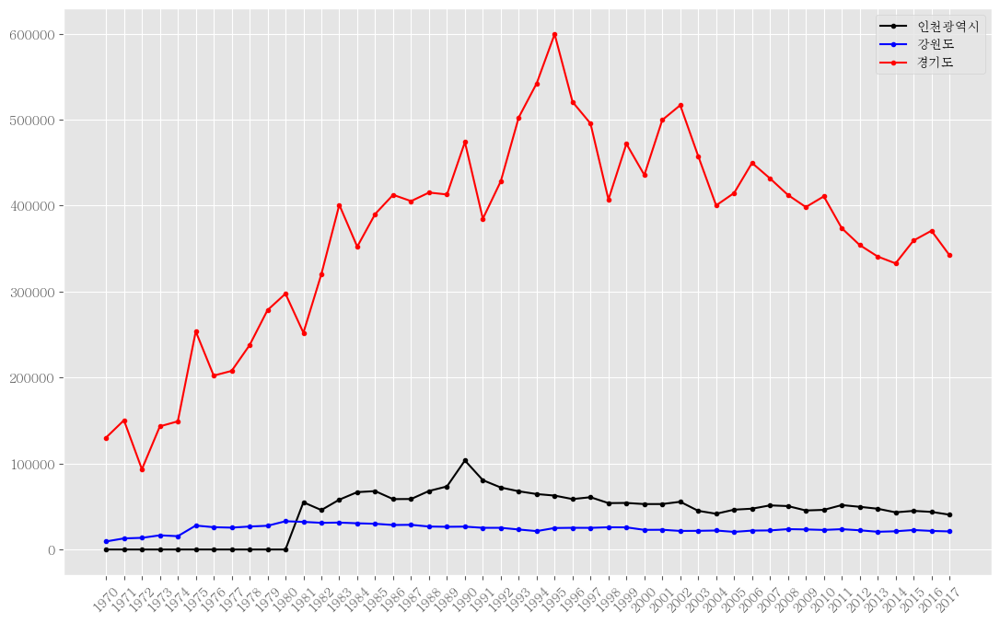

In [123]:
df_seoul = df[(df['전출지별'] == '서울특별시') & (df['전입지별'] != '서울특별시')]
df_seoul = df_seoul.drop(columns=['전출지별'])
df_seoul.set_index('전입지별',inplace=True)
df_seoul

plt.figure(figsize=(13,8)) # 그래프 크기 조정
# 서울에서 -> 지방자치덴체
def escapeSeoul(df, region, color='black', marker='o'):
    temp = df.loc[region]
    plt.plot(temp.index, temp.values, color=color, label=region, marker = marker, markersize = 3) # 그리기, 선 그래프

escapeSeoul(df_seoul,'인천광역시')
escapeSeoul(df_seoul,'강원도','blue')
escapeSeoul(df_seoul,'경기도','red')


# 그래프 설정
plt.xticks(rotation=45) # x축 rotation
plt.legend() # 범례
plt.show() # 객체정보 없애기

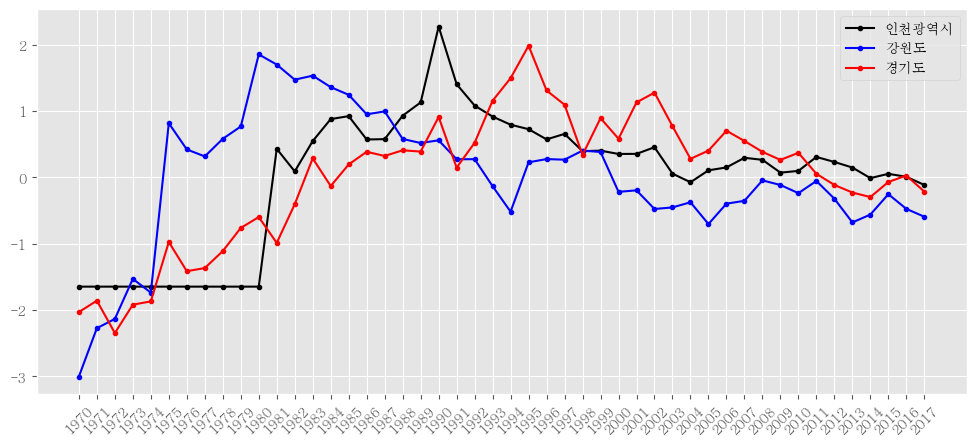

In [121]:
# 데이터를 정규화
# z-score (x - 평균) / 표준편차
# 인천광역시 강원도 경기도 데이터를 정규화 그래프로 그려보자
def zscore(region):
    m = df_seoul.loc[region].mean()
    s = df_seoul.loc[region].std()
    return df_seoul.loc[region].apply(lambda x : (x-m)/s)

df_seoul.loc['인천광역시'] = zscore('인천광역시')
df_seoul.loc['강원도'] = zscore('강원도')
df_seoul.loc['경기도'] = zscore('경기도')

plt.style.use('ggplot')
plt.figure(figsize=(12,5)) # 그래프 크기 조정

escapeSeoul(df_seoul,'인천광역시')
escapeSeoul(df_seoul,'강원도','blue')
escapeSeoul(df_seoul,'경기도','red')

# 그래프 설정
plt.rcParams['axes.unicode_minus'] = False
plt.xticks(rotation=45) # x축 rotation
plt.legend() # 범례
plt.show() # 객체정보 없애기



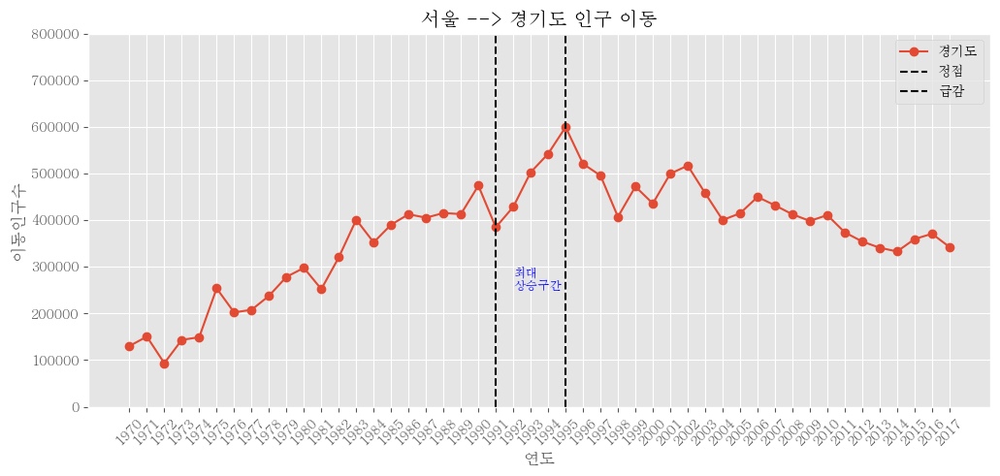

In [151]:
df_seoul = df[(df['전출지별'] == '서울특별시') & (df['전입지별'] != '서울특별시')]
df_seoul = df_seoul.drop(columns=['전출지별'])
df_seoul.set_index('전입지별',inplace=True)
df_seoul
# 꾸미기
# 서울 -> 경기도
plt.style.use('ggplot')
plt.figure(figsize=(12,5)) # 그래프 크기 조정
X = df_seoul.loc['경기도'].index
y = df_seoul.loc['경기도'].values
plt.plot(X,y,marker='o',label='경기도')
plt.title('서울 --> 경기도 인구 이동')
plt.xlabel('연도')
plt.ylabel('이동인구수')
# plt.xlim('1991','1999')
plt.ylim(0,800000)
# plt.legend(['경기도'])
# x = '1995' 세로로 선을 그린다
plt.axvline(x='1995',color = 'black', linestyle='--', label='정점')
plt.axvline(x='1991',color = 'black', linestyle='--', label='급감')
plt.rcParams['axes.unicode_minus'] = False
plt.xticks(rotation=45) # x축 rotation
plt.text('1992', 250000, '최대\n상승구간', color='blue', fontsize=9)
plt.legend()
plt.show()


In [152]:
# 서울 -> 인천
# 서울 -> 경기

In [155]:
seoulToOtherDf = df[(df['전출지별'] == '서울특별시') & (df['전입지별'] != '서울특별시')]
seoulToOtherDf = seoulToOtherDf.drop(columns=['전출지별'])
seoulToOtherDf = seoulToOtherDf.set_index('전입지별')
seoulToOtherDf.head()

,1970,1971,1972,1973,1974,1975,1976,1977,1978,1979,...,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
전입지별,,,,,,,,,,,,,,,,,,,,,
전국,1448985,1419016,1210559,1647268,1819660,2937093,2495620,2678007,3028911,2441242,...,2083352,1925452,1848038,1834806,1658928,1620640,1661425,1726687,1655859,1571423
부산광역시,11568,11130,11768,16307,22220,27515,23732,27213,29856,28542,...,17353,17738,17418,18816,16135,16153,17320,17009,15062,14484
대구광역시,0,0,0,0,0,0,0,0,0,0,...,9720,10464,10277,10397,10135,10631,10062,10191,9623,8891
인천광역시,0,0,0,0,0,0,0,0,0,0,...,50493,45392,46082,51641,49640,47424,43212,44915,43745,40485
광주광역시,0,0,0,0,0,0,0,0,0,0,...,10846,11725,11095,10587,10154,9129,9759,9216,8354,7932


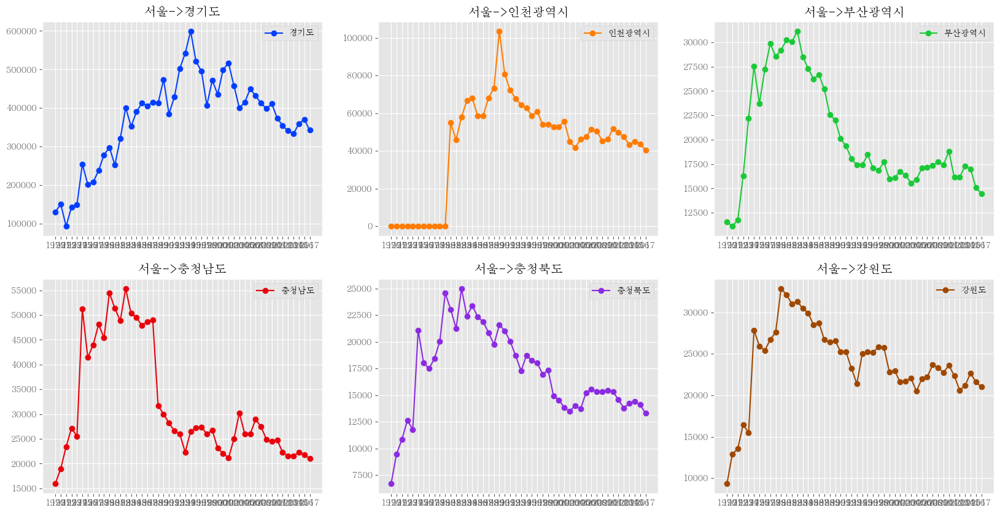

In [182]:
fig = plt.figure(figsize=(20,10)) # 전체크기
plt.style.use('ggplot')
import seaborn as sns
# import random
palette = sns.color_palette('bright', 20) # 10개의 색상으로 구성된 팔레트
# random.choice(palette)

for idx, region in enumerate(['경기도','인천광역시','부산광역시','충청남도','충청북도','강원도']):
    plt.subplot(2,3,idx+1) # 첫번째 칸
    plt.title(f'서울->{region}')
    plt.plot(seoulToOtherDf.loc[region].index, 
             seoulToOtherDf.loc[region].values,
             label=region, marker='o',color=palette[idx])
    plt.legend()

plt.show()

<Axes: >

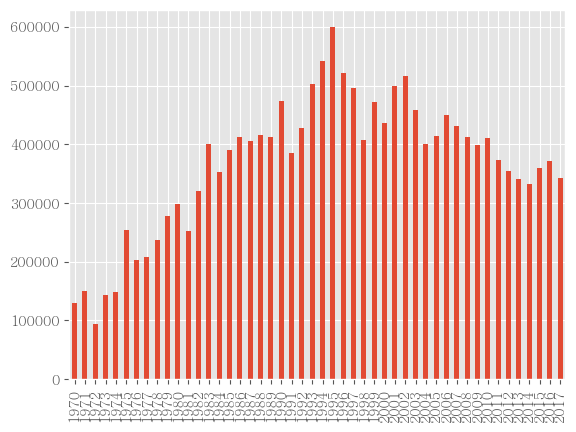

In [183]:
# kind는 DataFrame에 줘야한다
seoulToOtherDf.loc['경기도'].plot(kind='bar')

C:\Users\Playdata\AppData\Local\Temp\ipykernel_7956\723732055.py:1: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  seoulToOtherDf.loc['경기도'].plot(kind='pie')


<Axes: ylabel='경기도'>

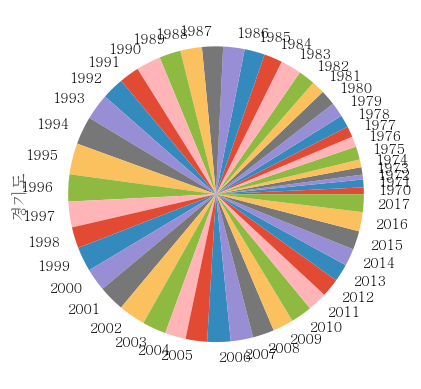

In [184]:
seoulToOtherDf.loc['경기도'].plot(kind='pie')

<Axes: >

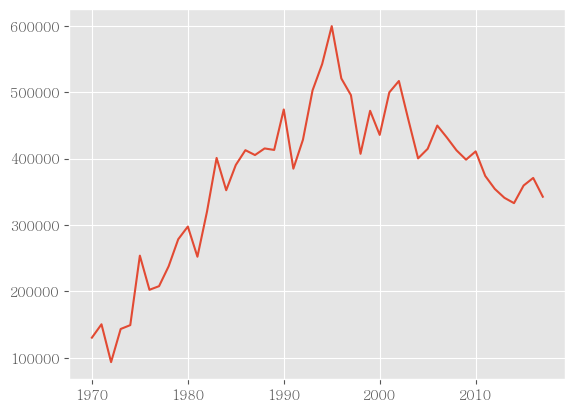

In [185]:
seoulToOtherDf.loc['경기도'].plot(kind='line')

<Axes: >

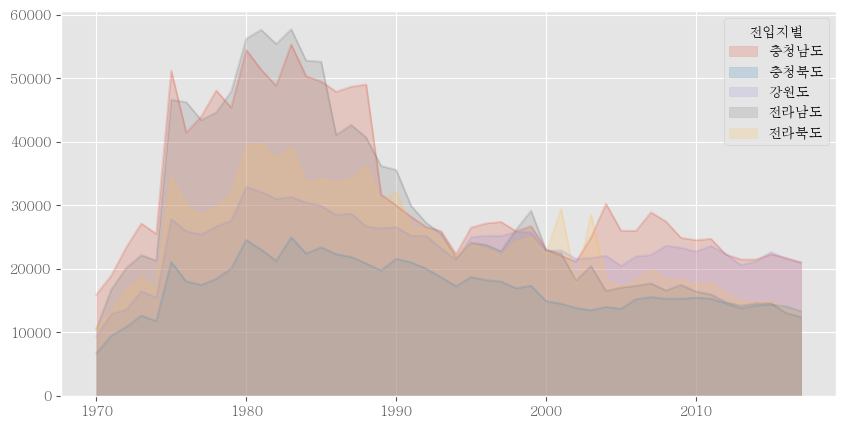

In [198]:
seoulToOtherDf.loc[['충청남도','충청북도', '강원도','전라남도', '전라북도']].T # index가 x축으로 가기 때문에
seoulToOtherDf.loc[['충청남도','충청북도', '강원도','전라남도', '전라북도']].T.plot(kind='area',stacked=False, alpha=0.2,  figsize=(10,5))

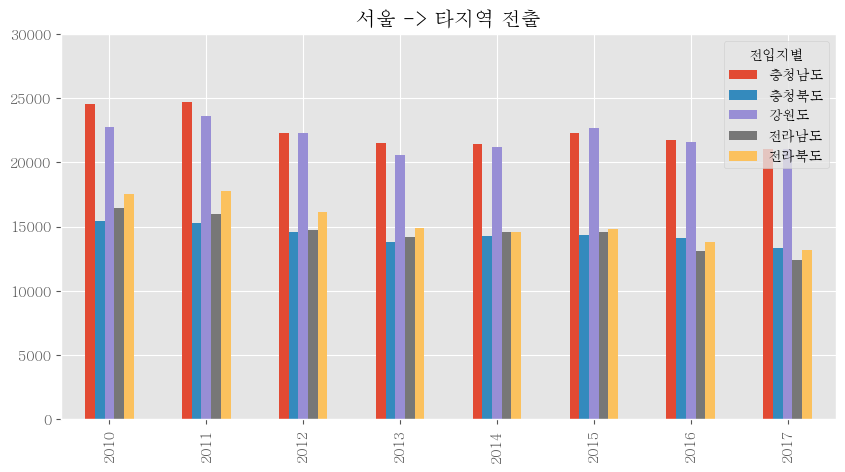

In [226]:
# 막대그래프 서울 -> ['충청남도','충청북도', '강원도','전라남도', '전라북도']
map(str, range(2010,2018))
temp = seoulToOtherDf.loc[['충청남도','충청북도', '강원도','전라남도', '전라북도'],map(str, range(2010,2018))].T

# 스타일 지정
plt.style.use('ggplot')
temp.index = temp.index.map(int)
temp.plot(kind='bar',figsize=(10,5))
plt.ylim(0,30000)
plt.title('서울 -> 타지역 전출')
plt.show()

Text(0.5, 1.0, '2010~2017 서울에서 타지역으로 이동')

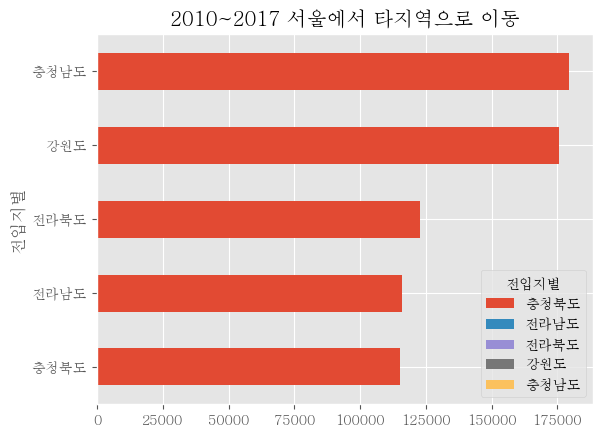

In [246]:
# 서울 -> 타지역 전출 합계
temp = seoulToOtherDf.loc[['충청남도','충청북도', '강원도','전라남도', '전라북도'],map(str, range(2010,2018))]
temp['합계'] = temp.sum(axis=1)
temp = temp.sort_values(by='합계')

temp.T.plot(kind='barh')
temp['합계'].T.plot(kind='barh')

plt.title('2010~2017 서울에서 타지역으로 이동')

In [247]:
# 시각화 도구
# plt.plot --> x와 y를 분리해서 시각화
# 여러 옵션이 있음

# DataFrame.plot(kind='') --> 데이터프레임 형태로 시각화
# 필요에 따라서 전처리가 필요하다
# 면적 그리기 : 스택이 쌓이는 구조가 기본구조

# 화면 분할.. subplot(row,col,pallet(영역순번)) : 영역 순번은 1

In [248]:
# 2010 ~
# 서울로 전입온 지방자치단체를 하나 선택해서 plot을 그려보자
# 몇 군데를 지정해서 DataFrame.plot을 그려보기

In [274]:
import pandas as pd
import matplotlib.pyplot as plt

In [280]:
df = pd.read_excel('C:\\Github\\python_study\\Pandas\\pandas-data-analysis-main\\part4\\data\\시도별_전출입_인구수.xlsx')
df.head()

,전출지별,전입지별,1970,1971,1972,1973,1974,1975,1976,1977,...,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
0,전출지별,전입지별,이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),...,이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명)
1,전국,전국,4046536,4210164,3687938,4860418,5297969,9011440,6773250,7397623,...,8808256,8487275,8226594,8127195,7506691,7411784,7629098,7755286,7378430,7154226
2,NaN,서울특별시,1742813,1671705,1349333,1831858,2050392,3396662,2756510,2893403,...,2025358,1873188,1733015,1721748,1555281,1520090,1573594,1589431,1515602,1472937
3,NaN,부산광역시,448577,389797,362202,482061,680984,805979,724664,785117,...,514502,519310,519334,508043,461042,478451,485710,507031,459015,439073
4,NaN,대구광역시,-,-,-,-,-,-,-,-,...,409938,398626,370817,370563,348642,351873,350213,351424,328228,321182


In [281]:
df = df.ffill()
df.head()

,전출지별,전입지별,1970,1971,1972,1973,1974,1975,1976,1977,...,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
0,전출지별,전입지별,이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),...,이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명),이동자수 (명)
1,전국,전국,4046536,4210164,3687938,4860418,5297969,9011440,6773250,7397623,...,8808256,8487275,8226594,8127195,7506691,7411784,7629098,7755286,7378430,7154226
2,전국,서울특별시,1742813,1671705,1349333,1831858,2050392,3396662,2756510,2893403,...,2025358,1873188,1733015,1721748,1555281,1520090,1573594,1589431,1515602,1472937
3,전국,부산광역시,448577,389797,362202,482061,680984,805979,724664,785117,...,514502,519310,519334,508043,461042,478451,485710,507031,459015,439073
4,전국,대구광역시,-,-,-,-,-,-,-,-,...,409938,398626,370817,370563,348642,351873,350213,351424,328228,321182


In [284]:
df.columns
df.index

RangeIndex(start=0, stop=325, step=1)

In [285]:
df['전출지별'].unique()

array(['전출지별', '전국', '서울특별시', '부산광역시', '대구광역시', '인천광역시', '광주광역시', '대전광역시',
       '울산광역시', '세종특별자치시', '경기도', '강원도', '충청북도', '충청남도', '전라북도', '전라남도',
       '경상북도', '경상남도', '제주특별자치도'], dtype=object)

In [286]:
# 산점도 - 데이터 분호
# 파이차트 - 비율로 표현
# boxplot - 데이터를 4분위수로 표현, 노란색 선 : 중위수, 이상치 판별
# 히트맵 - 상관관계

<Axes: xlabel='weight', ylabel='mpg'>

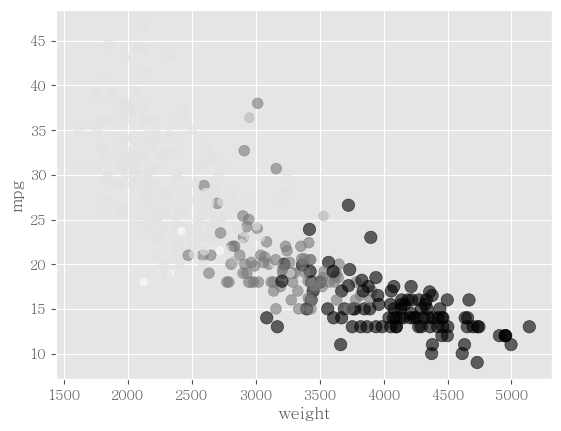

In [304]:
# 산점도
import seaborn as sns
# pd.read_csv('C:\\Github\\python_study\\Pandas\\pandas-data-analysis-main\\part4\\data\\auto-mpg.csv', header=None)
df = sns.load_dataset('mpg')
df.head()
cylinder_size = df['cylinders']*10
palette = sns.color_palette('bright',len(df['cylinders'].unique()))
df['cylinders']
df.plot(kind='scatter',x='weight',y='mpg', alpha = 0.6, s=cylinder_size, c=cylinder_size) # alpha : 투명도, s : 원 크기, c : 색상

<Axes: >

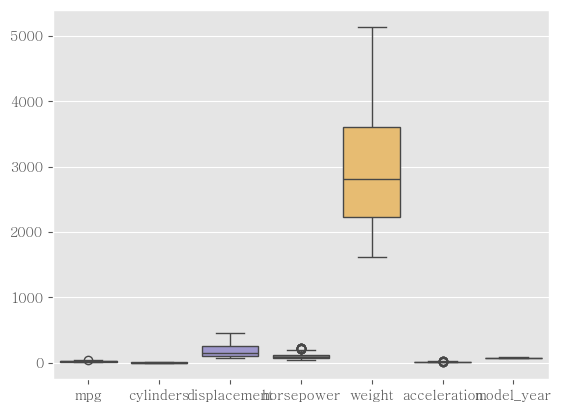

In [309]:
sns.boxplot(df)

<Axes: xlabel='origin', ylabel='mpg'>

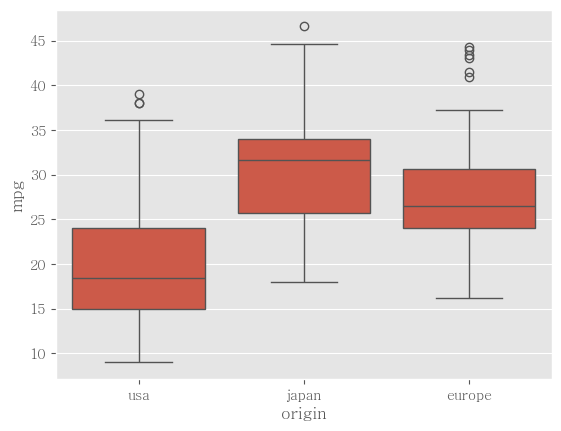

In [307]:
# 파이차트
# boxplot - plt.subplot 사용해서 나누어 그리기
sns.boxplot(df, x='origin', y='mpg')

<Axes: >

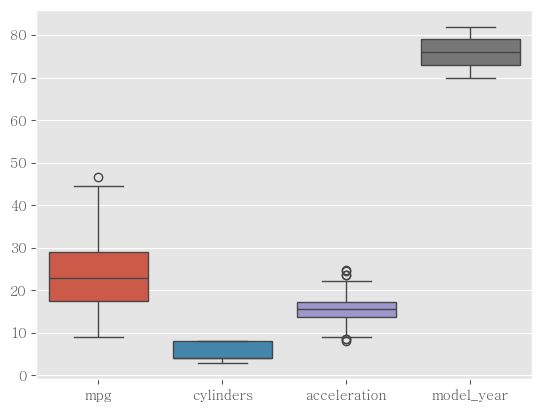

In [314]:
df2 = df.drop(columns=['weight', 'displacement', 'horsepower'])
sns.boxplot(df2)

In [315]:
# p.217 박스플롯
# 1분위수, 2분위수(중앙값), 3분위수 = 1Q, 2Q, 3Q
# IQR : Q3-Q1 (박스 간격)
# Q1 - 1.5*IQR, Q3 + 1.5*IQR

<Axes: ylabel='horsepower'>

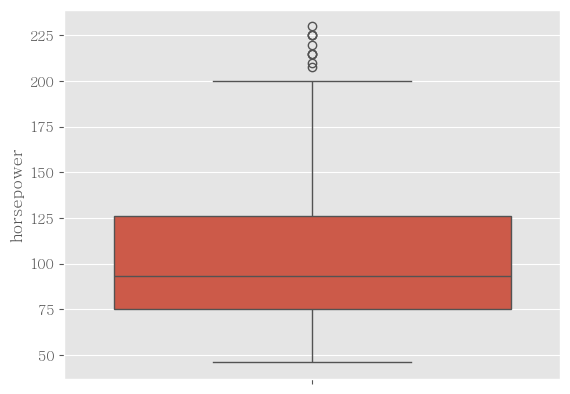

In [317]:
# 이상치 확인 및 제거
# Q1 - 1.5*IQR <= Data <= Q3 + 1.5*IQR
sns.boxplot(df['horsepower'])

6      220.0
7      215.0
8      225.0
13     225.0
25     215.0
27     210.0
67     208.0
94     215.0
95     225.0
116    230.0
Name: horsepower, dtype: float64


<Axes: ylabel='horsepower'>

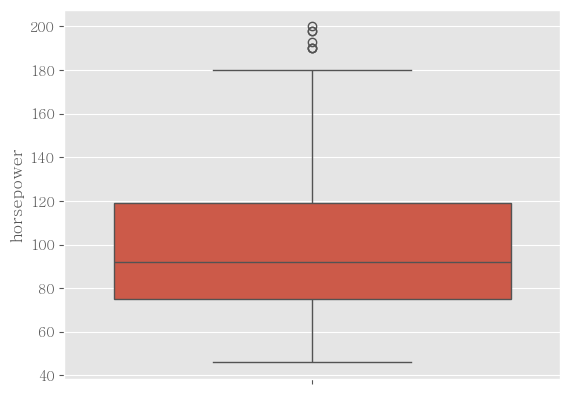

In [327]:
Q1 = df['horsepower'].quantile(0.25)
Q3 = df['horsepower'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR
# 이상치
print(df[(df['horsepower'] >  upper_bound) | (df['horsepower'] < lower_bound)]['horsepower']) # 이상치
new_df = df[~((df['horsepower'] >  upper_bound) | (df['horsepower'] < lower_bound))]['horsepower'] # 정상데이터
sns.boxplot(new_df)

<Axes: ylabel='weight'>

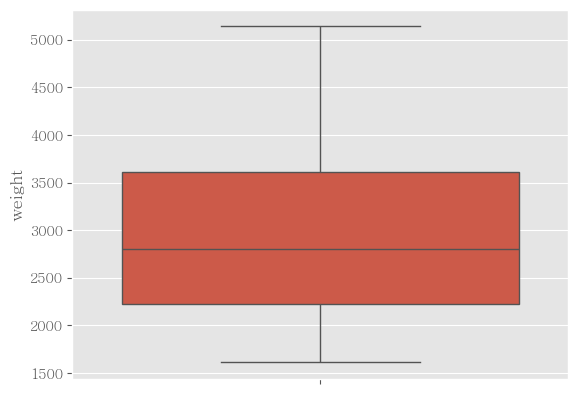

In [329]:
sns.boxplot(df['weight'])
# 가장 이상적인 형태는 위 아래 간격이 같고 중위수 가운데 있을 때
# 중위수가 아래로 치우쳐 있다 - 전체 데이터 중 전반적인 무게 분포가 낮게 형성되어 있음
# 4등분으로 나뉨

In [335]:
iris = sns.load_dataset('iris')
iris['species'].unique() # 붓꽃
iris

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa
...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica
146,6.3,2.5,5.0,1.9,virginica
147,6.5,3.0,5.2,2.0,virginica
148,6.2,3.4,5.4,2.3,virginica


<Axes: xlabel='petal_length', ylabel='petal_width'>

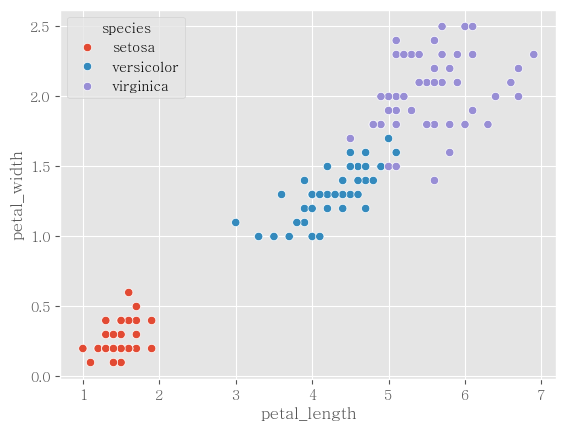

In [338]:
sns.scatterplot(iris,x='petal_length', y= 'petal_width',hue='species')
# 클러스터(군집)을 이룸

<Axes: xlabel='petal_length', ylabel='petal_width'>

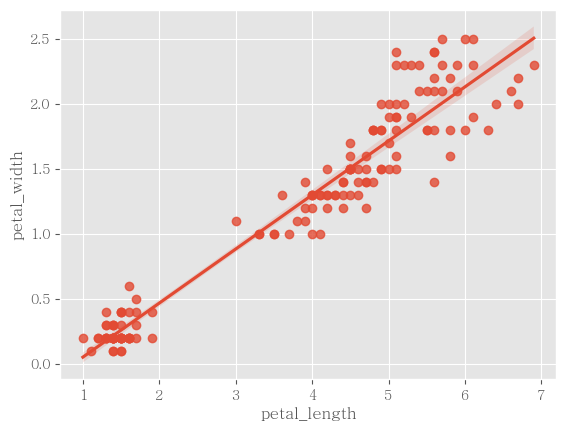

In [340]:
# 회귀선 있는 산점도
sns.regplot(iris,x='petal_length', y= 'petal_width') # 자동으로 선형회귀

Index(['mpg', 'cylinders', 'displacement', 'horsepower', 'weight',
       'acceleration', 'model_year', 'origin', 'name'],
      dtype='object')


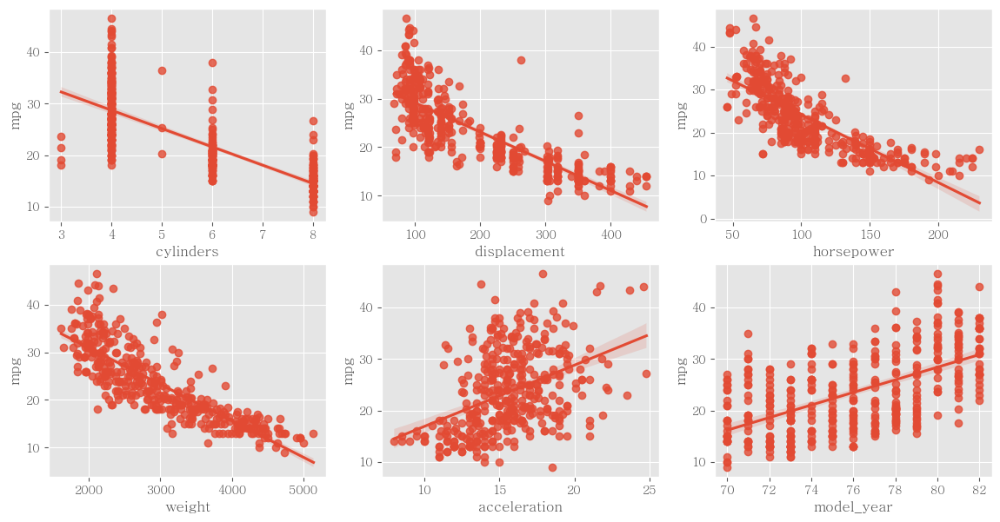

In [348]:
# 회귀 - 예측
mpg = sns.load_dataset('mpg')
print(mpg.columns)
plt.figure(figsize=(14,7))
for i, col in enumerate(mpg.columns[1:-2]):
    plt.subplot(2,3,i+1)
    sns.regplot(mpg, y='mpg', x=col)


In [349]:
# 상관관계 <-> 인과관계 : 둘 차이 다름이 중요!!
# 예시 : 공부시간과 성적
# trade off 관계를 지우고 독립변수로

In [353]:
numeric_mpg = mpg.select_dtypes(include=[int,float])
numeric_mpg.corr()

,mpg,cylinders,displacement,horsepower,weight,acceleration,model_year
mpg,1.000000,-0.775396,-0.804203,-0.778427,-0.831741,0.420289,0.579267
cylinders,-0.775396,1.000000,0.950721,0.842983,0.896017,-0.505419,-0.348746
displacement,-0.804203,0.950721,1.000000,0.897257,0.932824,-0.543684,-0.370164
horsepower,-0.778427,0.842983,0.897257,1.000000,0.864538,-0.689196,-0.416361
weight,-0.831741,0.896017,0.932824,0.864538,1.000000,-0.417457,-0.306564
acceleration,0.420289,-0.505419,-0.543684,-0.689196,-0.417457,1.000000,0.288137
model_year,0.579267,-0.348746,-0.370164,-0.416361,-0.306564,0.288137,1.000000


<Axes: >

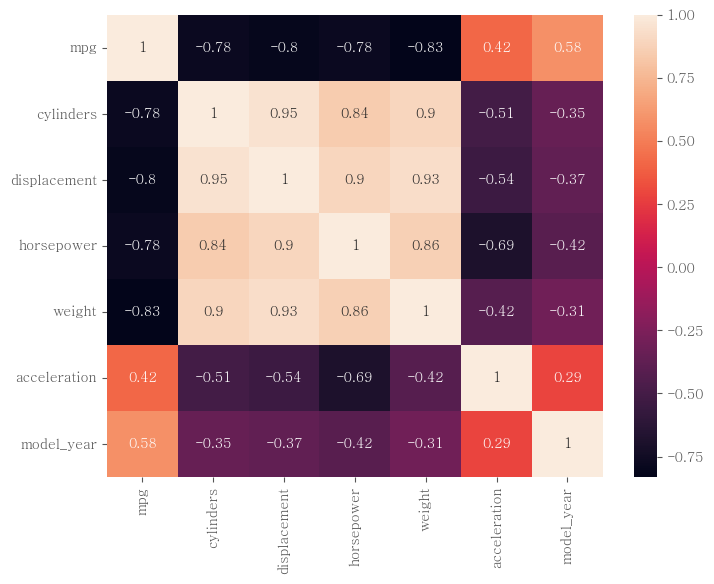

In [358]:
plt.figure(figsize=(8,6))
sns.heatmap(numeric_mpg.corr(), annot=True)

In [359]:
# 막대그래프
titanic = sns.load_dataset('titanic')
titanic.head()
# sns.barplot(mpg, x=)
# 양, 조깅, 클러스터

,survived,pclass,sex,age,sibsp,parch,fare,embarked,class,who,adult_male,deck,embark_town,alive,alone
0,0,3,male,22.0,1,0,7.2500,S,Third,man,True,NaN,Southampton,no,False
1,1,1,female,38.0,1,0,71.2833,C,First,woman,False,C,Cherbourg,yes,False
2,1,3,female,26.0,0,0,7.9250,S,Third,woman,False,NaN,Southampton,yes,True
3,1,1,female,35.0,1,0,53.1000,S,First,woman,False,C,Southampton,yes,False
4,0,3,male,35.0,0,0,8.0500,S,Third,man,True,NaN,Southampton,no,True


<Axes: xlabel='sex', ylabel='survived'>

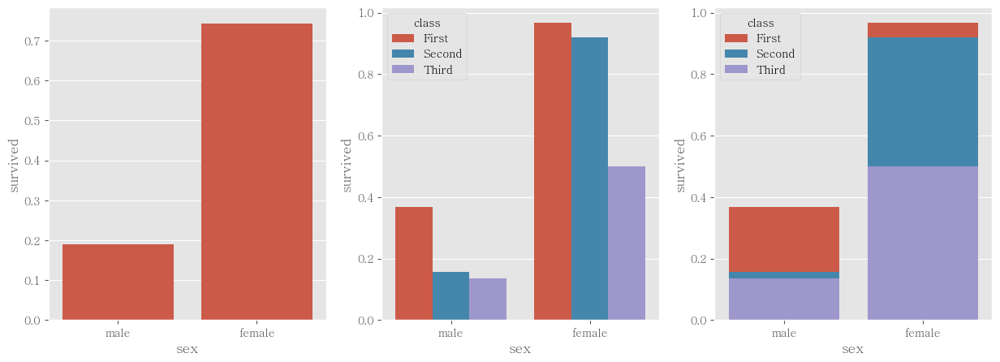

In [367]:
plt.figure(figsize=(15,5))
plt.subplot(1,3,1)

sns.barplot(titanic, x='sex', y='survived',errorbar=('ci', False))

plt.subplot(1,3,2)
sns.barplot(titanic, x='sex', y='survived', hue='class',errorbar=('ci', False))

plt.subplot(1,3,3)
sns.barplot(titanic, x='sex', y='survived', hue='class', dodge = False, errorbar=('ci', False))

sex
male      577
female    314
Name: count, dtype: int64

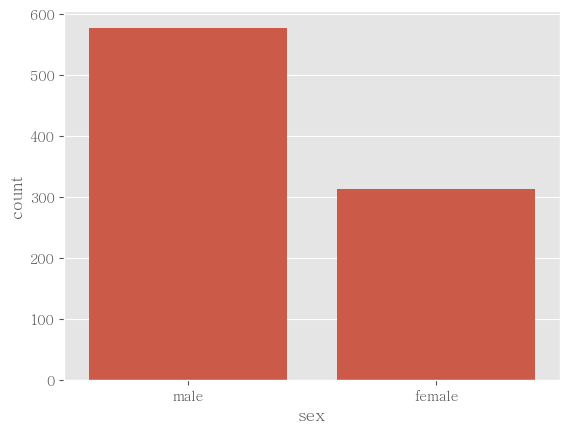

In [374]:
sns.countplot(titanic, x='sex')
titanic['sex'].value_counts()


C:\Users\Playdata\AppData\Local\Temp\ipykernel_7956\800319259.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  g = titanic.groupby(['sex','class'])


sex     class 
female  First      94
        Second     76
        Third     144
male    First     122
        Second    108
        Third     347
Name: survived, dtype: int64

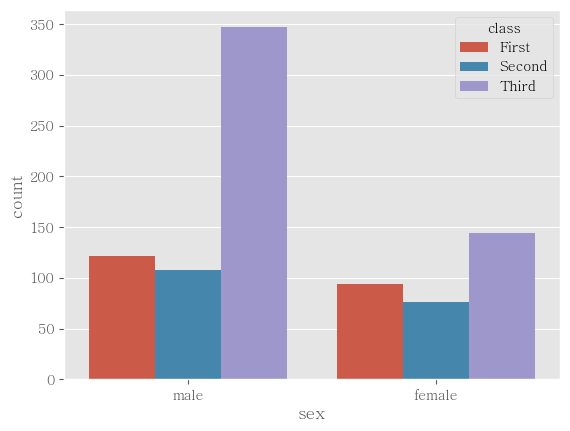

In [376]:
sns.countplot(titanic, x='sex', hue='class')
g = titanic.groupby(['sex','class'])
g['survived'].count()

In [377]:
# Folium 라이브러리
!pip install folium

In [419]:
import folium
m = folium.Map(location=(37.55, 127), zoom_start=12)
m

In [416]:
# 마커 표시
seoul_uni = 'C:\\Github\\python_study\\Pandas\\pandas-data-analysis-main\\part4\\data\\서울지역_대학교_위치.xlsx'

In [422]:
import pandas as pd
df = pd.read_excel(seoul_uni)
df = df.rename(columns={
    'Unnamed: 0':'이름'
})
df.head()

,이름,위도,경도
0,KAIST 서울캠퍼스,37.592573,127.046737
1,KC대학교,37.548345,126.854797
2,가톨릭대학교(성신교정),37.585922,127.004328
3,가톨릭대학교(성의교정),37.499623,127.006065
4,감리교신학대학교,37.567645,126.961610


In [423]:
for name, lat, lng in df[['이름','위도','경도']].values:
    folium.Marker(
        [lat,lng],
        popup=name
    ).add_to(m)
m

In [424]:
from folium.plugins import MarkerCluster
m = folium.Map(location=(37.55, 127), zoom_start=12)
marker_cluster = MarkerCluster().add_to(m)
for name, lat, lng in df[['이름','위도','경도']].values:
    folium.Marker(
        [lat,lng],
        popup=name
    ).add_to(marker_cluster)
m

In [425]:
# keggle
# https://www.kaggle.com/code/yantaoxi/house-prices-regression-analysis-eda
# https://dacon.io/

In [427]:
# sns.pairplot(df,hue=)

상권

In [429]:
from glob import glob

In [431]:
store_lists = glob('./store/*.csv')
store_lists

['./store\\소상공인시장진흥공단_상가(상권)정보_강원_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_경기_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_경남_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_경북_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_광주_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_대구_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_대전_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_부산_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_서울_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_세종_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_울산_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_인천_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_전남_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_전북_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_제주_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_충남_202406.csv',
 './store\\소상공인시장진흥공단_상가(상권)정보_충북_202406.csv']

In [433]:
store_df_lists = [pd.read_csv(file,low_memory=False) for file in store_lists]

In [435]:
total_store_df = pd.concat(store_df_lists)
total_store_df.shape

(2338043, 39)

In [438]:
total_store_df.reset_index(drop=True)

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
0,MA0101202210A0084547,금강산노래광장,NaN,I2,음식,I211,주점,I21101,일반 유흥 주점,I56211,...,4217010300007470000000086,파크장,강원특별자치도 동해시 송정로 11,240806,25789,NaN,지,NaN,129.127525,37.495265
1,MA010120220805430903,엔젤,NaN,I2,음식,I201,한식,I20101,백반/한정식,I55109,...,4277032022103660000008290,NaN,강원특별자치도 정선군 남면 민둥산로 175-13,233837,26148,NaN,NaN,NaN,128.792089,37.259788
2,MA010120220805430941,누베헤어,NaN,S2,수리·개인,S207,이용·미용,S20701,미용실,S96112,...,4211012500100440010000008,춘천파크자이,강원특별자치도 춘천시 스포츠타운길 460,200200,24472,NaN,3,NaN,127.707653,37.867744
3,MA010120220805430946,공차,NaN,I2,음식,I212,비알코올,I21201,카페,I56229,...,4213033023113500001000001,NaN,강원특별자치도 원주시 지정면 신지정로 211,220821,26354,NaN,NaN,NaN,127.872713,37.374189
4,MA010120220805431369,행운쉼터,NaN,I1,숙박,I101,일반 숙박,I10103,펜션,I55104,...,4281032022008200005013654,NaN,강원특별자치도 인제군 북면 금강로 751,252826,24609,NaN,NaN,NaN,128.207086,38.171871
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2338038,MA0101202311A0060835,대박마라탕청대점,NaN,I2,음식,I202,중식,I20202,마라탕/훠궈,I56121,...,4311111300102240004032580,NaN,충청북도 청주시 청원구 대성로 285-1,363813,28505,NaN,1,NaN,127.490207,36.650677
2338039,MA0101202311A0044212,강곰아돌지,NaN,P1,교육,P105,일반 교육,P10501,입시·교과학원,P85501,...,4311111300103310028046220,NaN,충청북도 청주시 청원구 사북로121번길 26,363814,28538,NaN,NaN,NaN,127.484409,36.646227
2338040,MA0101202310A0046622,케이팝스타코인노래.멀티게임,NaN,R1,예술·스포츠,R104,유원지·오락,R10405,기타 오락장,R91229,...,4311325026107180000000001,오송생명타워,충청북도 청주시 흥덕구 오송읍 오송생명5로 184-4,361951,28165,NaN,NaN,NaN,127.329639,36.630533
2338041,MA0101202310A0071018,이에스,NaN,S2,수리·개인,S207,이용·미용,S20701,미용실,S96112,...,4311310200103660040005720,NaN,충청북도 청주시 서원구 창직로 18,362833,28664,NaN,1,NaN,127.463704,36.630725


In [439]:
total_store_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2338043 entries, 0 to 78830
Data columns (total 39 columns):
 #   Column     Dtype  
---  ------     -----  
 0   상가업소번호     object 
 1   상호명        object 
 2   지점명        object 
 3   상권업종대분류코드  object 
 4   상권업종대분류명   object 
 5   상권업종중분류코드  object 
 6   상권업종중분류명   object 
 7   상권업종소분류코드  object 
 8   상권업종소분류명   object 
 9   표준산업분류코드   object 
 10  표준산업분류명    object 
 11  시도코드       int64  
 12  시도명        object 
 13  시군구코드      int64  
 14  시군구명       object 
 15  행정동코드      int64  
 16  행정동명       object 
 17  법정동코드      int64  
 18  법정동명       object 
 19  지번코드       int64  
 20  대지구분코드     int64  
 21  대지구분명      object 
 22  지번본번지      float64
 23  지번부번지      float64
 24  지번주소       object 
 25  도로명코드      float64
 26  도로명        object 
 27  건물본번지      float64
 28  건물부번지      float64
 29  건물관리번호     object 
 30  건물명        object 
 31  도로명주소      object 
 32  구우편번호      int64  
 33  신우편번호      int64  
 34  동정보        float64
 35  층

In [442]:
# 데이터베이스 설계
# 상권업종대분류코드...
# 코드는 명과 같은 값이므로 코드로 끝나는 이름 없애기
remove_cols = [col for col in total_store_df.columns if '코드' in col]
total_store_df = total_store_df.drop(columns=remove_cols)
total_store_df.head()

,상가업소번호,상호명,지점명,상권업종대분류명,상권업종중분류명,상권업종소분류명,표준산업분류명,시도명,시군구명,행정동명,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
0,MA0101202210A0084547,금강산노래광장,NaN,음식,주점,일반 유흥 주점,일반 유흥 주점업,강원특별자치도,동해시,송정동,...,4217010300007470000000086,파크장,강원특별자치도 동해시 송정로 11,240806,25789,NaN,지,NaN,129.127525,37.495265
1,MA010120220805430903,엔젤,NaN,음식,한식,백반/한정식,기타 일반 및 생활 숙박시설 운영업,강원특별자치도,정선군,남면,...,4277032022103660000008290,NaN,강원특별자치도 정선군 남면 민둥산로 175-13,233837,26148,NaN,NaN,NaN,128.792089,37.259788
2,MA010120220805430941,누베헤어,NaN,수리·개인,이용·미용,미용실,두발 미용업,강원특별자치도,춘천시,강남동,...,4211012500100440010000008,춘천파크자이,강원특별자치도 춘천시 스포츠타운길 460,200200,24472,NaN,3,NaN,127.707653,37.867744
3,MA010120220805430946,공차,NaN,음식,비알코올,카페,기타 비알코올 음료점업,강원특별자치도,원주시,지정면,...,4213033023113500001000001,NaN,강원특별자치도 원주시 지정면 신지정로 211,220821,26354,NaN,NaN,NaN,127.872713,37.374189
4,MA010120220805431369,행운쉼터,NaN,숙박,일반 숙박,펜션,민박업,강원특별자치도,인제군,북면,...,4281032022008200005013654,NaN,강원특별자치도 인제군 북면 금강로 751,252826,24609,NaN,NaN,NaN,128.207086,38.171871


<Axes: xlabel='상권업종대분류명', ylabel='count'>

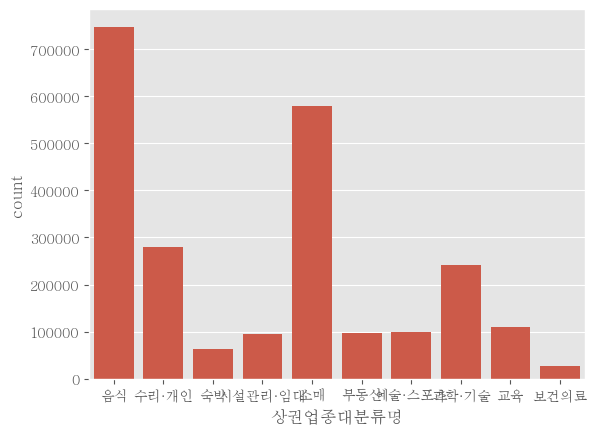

In [446]:
sns.countplot(total_store_df,x='상권업종대분류명')

In [447]:
total_store_df['시도명'].value_counts()

시도명
경기도        531738
서울특별시      460437
경상남도       155001
부산광역시      142206
경상북도       130102
인천광역시      107163
대구광역시      106297
충청남도       104524
강원특별자치도     92579
전라남도        91051
전북특별자치도     87589
충청북도        78831
대전광역시       68053
광주광역시       67767
제주특별자치도     52565
울산광역시       49228
세종특별자치시     12912
Name: count, dtype: int64

<Axes: xlabel='상권업종대분류명', ylabel='count'>

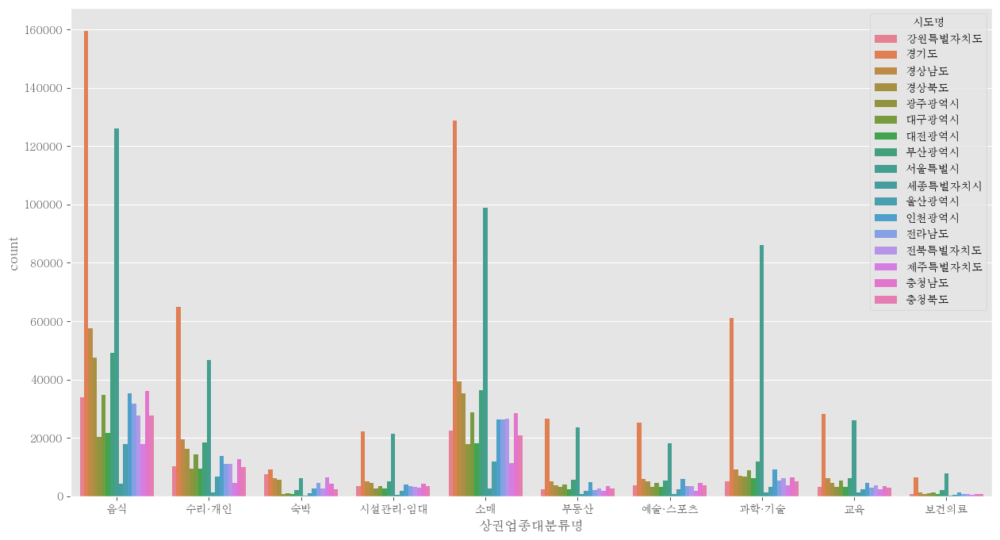

In [450]:
plt.figure(figsize=(15,8))
sns.countplot(total_store_df,x='상권업종대분류명',hue='시도명')

In [455]:
total_store_df['상권업종중분류명'].value_counts().index

Index(['한식', '이용·미용', '기타 간이', '섬유·의복·신발 소매', '종합 소매', '비알코올 ', '부동산 서비스',
       '주점', '기타 교육', '식료품 소매', '일반 숙박', '의약·화장품 소매', '유원지·오락', '자동차 수리·세차',
       '본사·경영 컨설팅', '기술 서비스', '전문 디자인', '스포츠 서비스', '광고', '가전·통신 소매', '일반 교육',
       '오락용품 소매', '중식', '철물·건설자재 소매', '의원', '일식', '청소·방제', '세탁', '서양식',
       '법무관련 ', '연료 소매', '기타 생활용품 소매', '인쇄·제품제작', '사진 촬영', '고용 알선', '회계·세무',
       '여행사·보조', '기타 가정용품 수리', '욕탕·신체관리', '기타 사업 서비스', '안경·정밀기기 소매', '가전제품 수리',
       '장식품 소매', '시계·귀금속 소매', '가구 소매', '교육 지원', '식물 소매', '기타 상품 소매', '도서관·사적지',
       '구내식당·뷔페', '애완동물·용품 소매', '중고 상품 소매', '자동차 부품 소매', '산업용품 대여', '가정용품 대여',
       '컴퓨터 수리', '시설관리', '동남아시아', '기타 숙박', '운송장비 대여', '수의', '기타 전문 과학',
       '담배 소매', '장례식장 ', '사무 지원', '모터사이클 수리', '병원', '음료 소매', '기타 보건', '기타 개인',
       '모터사이클 소매', '조경·유지', '통신장비 수리', '시장 조사', '기타 외국'],
      dtype='object', name='상권업종중분류명')

In [456]:
hakwon = total_store_df[total_store_df['상호명'].astype(str).apply(lambda x : True if '학원' in x else False)]
temp = hakwon.loc[:,['상호명','위도','경도']]
temp

,상호명,위도,경도
212,삼성영어정운셈수학학원,37.323415,127.981661
214,잉글리시아이입암영어학원,37.755668,128.909844
381,제이알음악줄넘기학원,37.762207,128.874514
385,대지영수학원,38.203090,128.567465
470,원주이용학원,37.329711,127.943643
...,...,...,...
78571,청주중장비학원,36.635807,127.479827
78668,어린음악대어린화가들오창원음악미술학원,36.733957,127.451622
78670,아이엘에스수학학원,36.630637,127.505937
78681,뷰티온피부미용학원,36.983176,127.941214


In [457]:
from folium.plugins import MarkerCluster
m = folium.Map(location=(37.55, 127), zoom_start=12)
marker_cluster = MarkerCluster().add_to(m)
for name, lat, lng in temp.values:
    folium.Marker(
        [lat,lng],
        popup=name
    ).add_to(marker_cluster)
m